This way one can draw only one country with [Plotly](https://plotly.com/) and [GeoJson](https://geojson.org/) data.

In [11]:
import json

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import seaborn as sns
from matplotlib.patches import Rectangle

In [12]:
# short names of federal districts
okrugsShort = {
    'Уральский федеральный округ': 'Уральский',
    'Северо-Западный федеральный округ': 'Северо-Западный',
    'Приволжский федеральный округ': 'Приволжский',
    'Южный федеральный округ': 'Южный',
    'Северо-Кавказский федеральный округ': 'Северо-Кавказский',
    'Центральный федеральный округ': 'Центральный',
    'Дальневосточный федеральный округ': 'Дальневосточный',
    'Сибирский федеральный округ': 'Сибирский'
}

# general names of federal districts
okrugs = [
    'Уральский федеральный округ', 'Северо-Западный федеральный округ',
    'Приволжский федеральный округ', 'Южный федеральный округ',
    'Северо-Кавказский федеральный округ', 'Центральный федеральный округ',
    'Сибирский федеральный округ', 'Дальневосточный федеральный округ'
]

In [13]:
# federal districts geojson
with open("russian_federal_district.geojson", encoding='utf-8') as json_file:
    jdata = json_file.read()
    level_3 = json.loads(jdata)

In [14]:
# coordinates of areas' borders
OKRUGs, COORDs = [], {}
for reg in level_3['features']:
    if reg['name'] in okrugs:
        OKRUGs.append(reg['name'])
        COORDs[reg['name']] = [r for r in reg['geometry']['coordinates']]

In [24]:
# provide some data
DATA = dict(zip(okrugs, [np.random.randint(1, 100) for _ in range(len(okrugs))]))
DATA

{'Уральский федеральный округ': 28,
 'Северо-Западный федеральный округ': 6,
 'Приволжский федеральный округ': 52,
 'Южный федеральный округ': 92,
 'Северо-Кавказский федеральный округ': 13,
 'Центральный федеральный округ': 27,
 'Сибирский федеральный округ': 32,
 'Дальневосточный федеральный округ': 17}

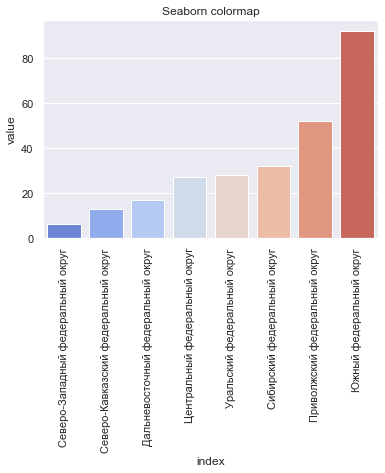

In [29]:
# map values of DATA to colors using seaborn
def get_hex(c):
    r, g, b, a = [int(cc * 255) for cc in c]
    return f"#{r:02x}{g:02x}{b:02x}"


vals = DATA.values()
names = DATA.keys()

M = list(sorted(zip(vals, names), key=lambda x: x[0]))
vals, names = [m[0] for m in M], [m[1] for m in M]

tabla = pd.DataFrame()
tabla['value'] = vals
tabla['index'] = names

fig, ax1 = plt.subplots(figsize=(6, 4))
sns.barplot(x='index', y='value', data=tabla, ax=ax1,
            palette='coolwarm')  # COLOR PALETTE == coolwarm
plt.xticks(rotation=90)
plt.title('Seaborn colormap')
plt.show()

bars = [r for r in ax1.get_children() if type(r) == Rectangle]
colors = [get_hex(c.get_facecolor()) for c in bars[:-1]]

COLORS = dict(zip(names, colors))

In [30]:
# draw figure
fig = go.Figure()

for name in OKRUGs:

    for coords in COORDs[name]:
        value = DATA[name]
        coords = np.array(coords[0])
        dataO = pd.DataFrame()
        dataO['lat'] = coords[:, 0]
        dataO['lon'] = coords[:, 1]
        if coords.shape[0] > 100:
            fig.add_trace(
                go.Scatter(
                    hovertext='text',
                    x=dataO['lat'],
                    y=dataO['lon'],
                    fill="toself",
                    text=f"{name} : Randomly generated data for this district is - {value}",
                    fillcolor=COLORS[name],
                    line=dict(width=0)))

fig.update_layout(xaxis_range=[0, 200])
fig.update_layout(showlegend=False)
fig.show()

In [32]:
# save your figure in html
fig.write_html('example.html', full_html=False, include_plotlyjs='cdn')